## Torsion profiles calculation notebook

For a given list of forcefield files and target directories creating a dataframe consisting of the chemical structure,  residual energies and relative energies plotted, and the associated barriers and wbos

In [1]:
import numpy as np
import os
import shutil
import pandas as pd 
from IPython.display import HTML
import sys
sys.path.append('../')
from energy_eval import *
import matplotlib.markers as mmark
from collections import defaultdict, OrderedDict
from bokeh.plotting import Figure
from plotmol.plotmol import default_tooltip_template

Note: Failed to import the optional openff.evaluator package. 
Note: Failed to import the optional openff.recharge package.


#### Defining the folders and list of forcefields and dataframe

In [2]:
target_dir = '/home/maverick/Desktop/OpenFF/openforcefield-forcebalance/tig_proof_of_concept/targets_matching_from_general_set/targets-nosterics'
subdirs= [f.path for f in os.scandir(target_dir) if f.is_dir()]

output_folder = 'compare_ff_tig_cj'
if os.path.isdir(output_folder):
    shutil.rmtree(output_folder)
os.mkdir(output_folder)

forcefields_list = ['/home/maverick/Desktop/OpenFF/openforcefield-forcebalance/tig_proof_of_concept/v1.3.0/result/optimize/tig_proof_of_concept_v130.offxml',
               'openff_unconstrained-1.3.0.offxml']

In [3]:
df = create_energy_dataframe(subdirs=subdirs, offxml_list=forcefields_list, molfile_format='mol.sdf', qdata_filename='qdata.txt')

In [3]:
df.loc[:,'mapped_smiles'] = pd.Series(np.random.randn(len(df)), index=df.index)
for i in range(len(df)):
    tid = df.iloc[i]['Torsion ID']
    mol = Molecule.from_file(target_dir+'/QCP-'+tid+'/mol.sdf', allow_undefined_stereo=True)
    df['mapped_smiles'][i] = mol.to_smiles(mapped=True)

NameError: name 'df' is not defined

In [4]:
# tig_df = pd.DataFrame(columns=df.columns.values)
# for i in range(len(df)):
#     if df.loc[i]['assigned params']['tig_proof_of_concept_v130'].startswith('TIG'):
#         tig_df = tig_df.append([df.loc[i]])

In [43]:
tig_df_sorted = pd.DataFrame(columns=df.columns.values)
for i in range(10):
    i=i+1
    for ii in range(len(df)):
        key = 'TIG'+str(i)
        if df.iloc[ii]['assigned params']['tig_proof_of_concept_v130'] == key:
            tig_df_sorted = tig_df_sorted.append(df.iloc[ii])

In [ ]:
# # print dataframe. 
cols = tig_df_sorted.columns.values
show_df = tig_df_sorted.loc[:, tig_df_sorted.columns != cols[3]]
show_df = show_df.loc[:, show_df.columns != cols[7]]
show_df = show_df.loc[:, show_df.columns != cols[8]]

# show_df = show_df.loc[:, show_df.columns != cols[0]]
HTML(show_df.to_html(escape=False))

In [7]:
df.to_pickle("./tigs_cj_general_set_data.pkl", compression='gzip')

In [4]:
df = pd.read_pickle("./tigs_cj_general_set_data.pkl", compression='gzip')

In [5]:
df.loc[:,'mapped_smiles'] = pd.Series(np.random.randn(len(df)), index=df.index)
for i in range(len(df)):
    tid = df.iloc[i]['Torsion ID']
    mol = Molecule.from_file(target_dir+'/QCP-'+tid+'/mol.sdf', allow_undefined_stereo=True)
    df['mapped_smiles'][i] = mol.to_smiles(mapped=True)

<ipython-input-5-e9f5ec5b9004>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['mapped_smiles'][i] = mol.to_smiles(mapped=True)
/home/maverick/anaconda3/envs/fb_dev_env/lib/python3.8/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [46]:
substi_phenyl_ids = ['3745357', '3745358', '3745359', '3745360', '3745361', '3745362', '3745363', '3745364', '3745365', '3745366', '3745367', '3745368', '3745369', '3745370', '3745371', '3745372', '3745373', '3745374', '3745375', '3745376', '3745377', '3745378', '3745379', '3745380', '3745381', '3745382', '3745383', '3745384', '3745385', '3745386', '3745387', '3745388', '3745389', '3745390', '3745391', '3745392', '3745393', '3745394', '3745395', '3745396', '3745397', '3745398', '3745399', '3745400', '3745401', '3745402', '3745403', '3745404', '3745405', '3745406', '3745407', '3745408', '3745409', '3745429', '3745461', '3745474', '3745475', '3745476', '3745477', '3745478', '3745479', '3745480', '3745481', '3745482', '3745483', '3745484', '3745485', '3745486', '3745487', '3745488', '3745489', '3745490', '3745491', '3745492', '3745493', '3745494', '3745495', '3745496', '3745497', '3745522', '3745535', '3745536', '3745537', '3745538', '3745539', '3745540', '3745541', '3745542', '3745543', '3745544', '3745545', '3745546', '3745547', '3745548', '3745549', '3745550', '3745551', '3745552', '3745553', '3745554', '3745555', '3745556', '3745557', '3745558', '3745559', '3745560', '3745561', '3745562', '3745563', '3745564', '3745565', '3745566', '3745567', '3745568', '3745569', '3745570', '3745571', '3745572', '3745573', '3745574', '3745575', '3745576', '3745577', '3745578', '3745579', '3745580', '3745581', '3745582', '3745583', '3745584', '3745585', '3745586', '3745587', '3745615', '3745617', '3745618', '3745620', '3745649', '3745654', '3745655', '3745656', '3745657', '3745658', '3745659', '4269703', '4269704', '4269705', '4269706', '4269707', '4269708', '4269709', '4269710', '4269711', '4269712', '19953579', '19953580', '19953581', '19953582', '19953583']

In [47]:
phenyl_set_df = df[[x in substi_phenyl_ids for x in df['Torsion ID']]]
non_phenyl_set_df = df[[x not in substi_phenyl_ids for x in df['Torsion ID']]]

In [48]:
print(len(phenyl_set_df))
print(len(non_phenyl_set_df))

105
416


,Torsion ID,assigned params,wbo,Chemical Structure,QM-MM_intrinsic relative energies,QM Vs MM_full
1,21272427,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",0.976487,,,
4,18535839,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",0.980546,,,
20,21272379,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",0.983077,,,
22,21272371,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",0.983060,,,
28,1762276,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",0.975602,,,
38,21272438,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",0.969462,,,
45,21272425,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",0.970327,,,
51,21540578,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",1.013062,,,
60,21272408,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",0.996531,,,
76,21272416,"{'tig_proof_of_concept_v130': 'TIG1', 'openff_unconstrained-1.3.0': 't43'}",1.017396,,,

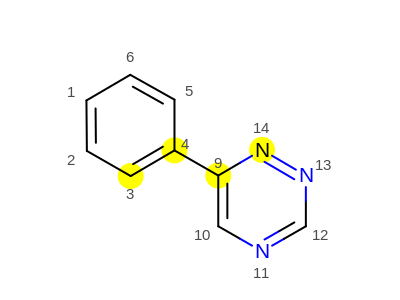
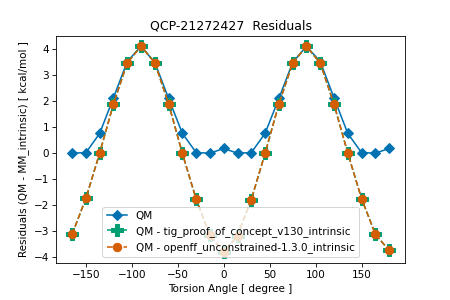
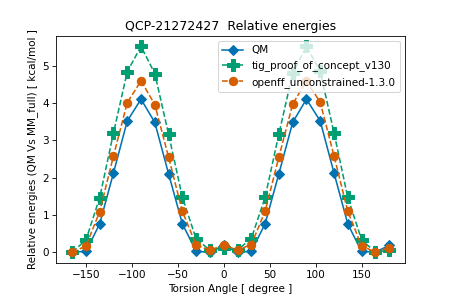
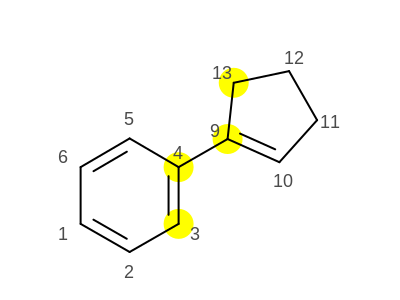
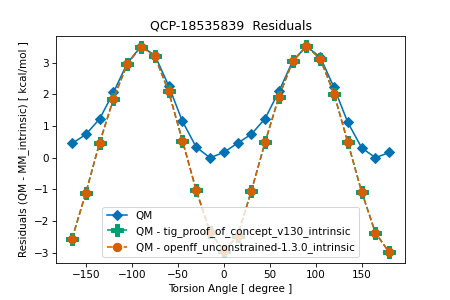
...
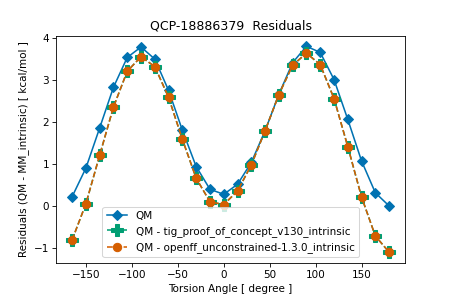
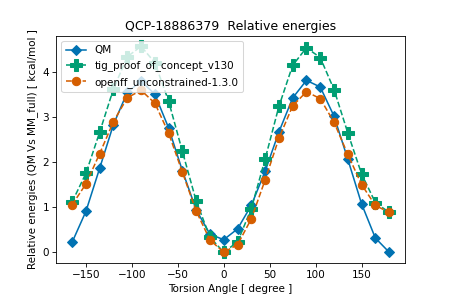
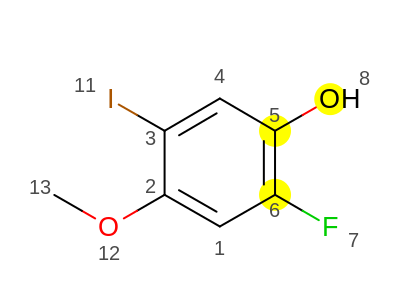
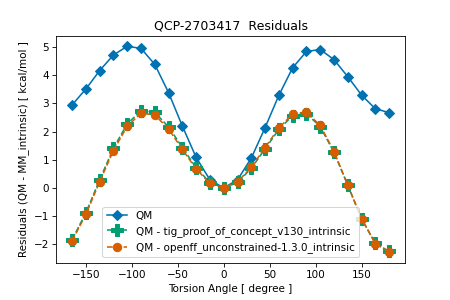
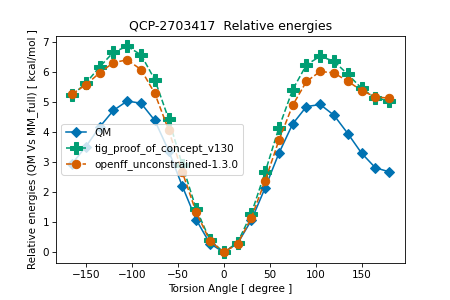

In [50]:
tig_df_sorted = pd.DataFrame(columns=non_phenyl_set_df.columns.values)
for i in range(10):
    i=i+1
    for ii in range(len(non_phenyl_set_df)):
        key = 'TIG'+str(i)
        if non_phenyl_set_df.iloc[ii]['assigned params']['tig_proof_of_concept_v130'] == key:
            tig_df_sorted = tig_df_sorted.append(non_phenyl_set_df.iloc[ii])

# # print dataframe. 
cols = tig_df_sorted.columns.values
show_df = tig_df_sorted.loc[:, tig_df_sorted.columns != cols[3]]
show_df = show_df.loc[:, show_df.columns != cols[7]]
show_df = show_df.loc[:, show_df.columns != cols[8]]
# show_df = show_df.loc[:, show_df.columns != cols[0]]
HTML(show_df.to_html(escape=False))

In [35]:
phenyl_full_set_df = pd.read_pickle("./barriers_data.pkl", compression='gzip')

In [31]:
tig_labels = {"TIG1" : "[*:1]~[#6X3:2]-[#6X3:3]~[*:4]", 
              "TIG2" : "[*:1]~[#6X3:2]-[#6X3$(*=[#8,#16,#7]):3]~[*:4]", 
              "TIG3" : "[*:1]~[#6X3:2]-[#6X3:3](-[#8H1])=[#8X1:4]",
              "TIG4" : "[*:1]~[#7X3:2]-!@[#6X3:3]~@[#6:4]",
              "TIG5" : "[#6X3:1]~[#7X3:2]-!@[#6X3:3]~@[#6:4]",
              "TIG6" : "[#6X3$(*~[#6]):1]~[#7X3:2]-!@[#6X3:3]~@[#6:4]",
              "TIG7" : "[#6X4:1]~[#7X3:2]-!@[#6X3:3]~@[#6:4]",
              "TIG8" : "[#8X1:1]~[#7X3:2]~[#6X3:3]~[*:4]",
              "TIG9" : "[*:1]~[#6X3:2]-[#8X2:3]-[*:4]",
              "TIG10" : "[*:1]~[#6X3:2]-[#8X2:3]-[#1:4]"}

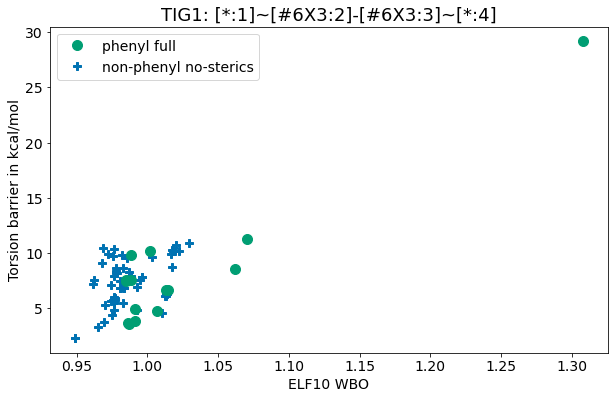

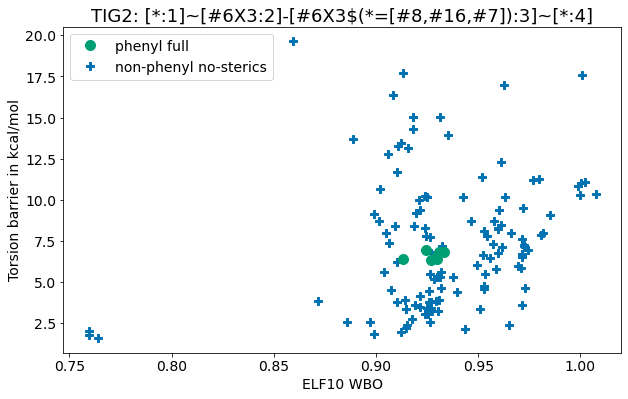

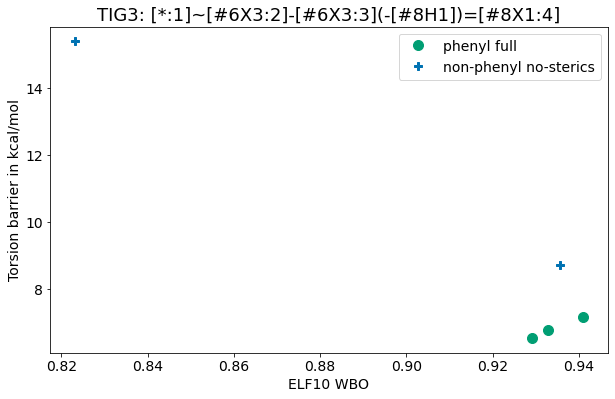

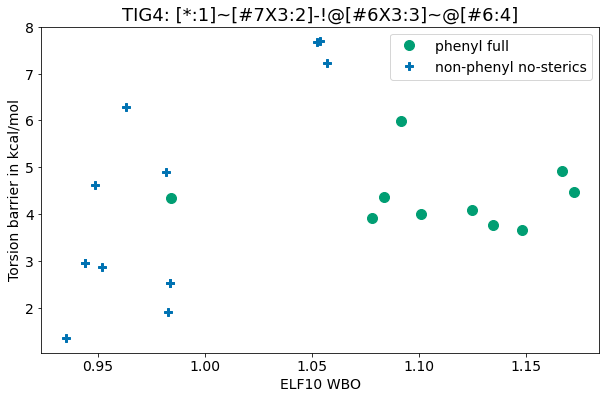

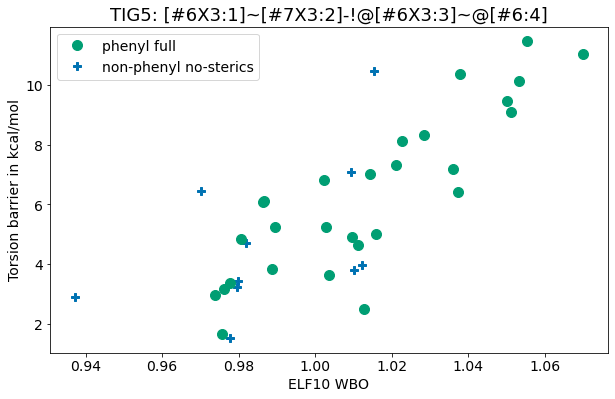

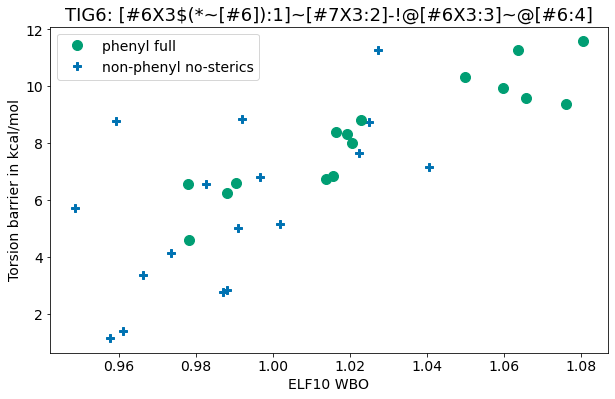

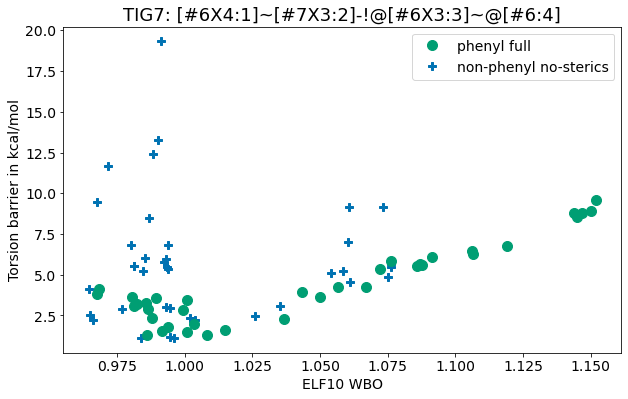

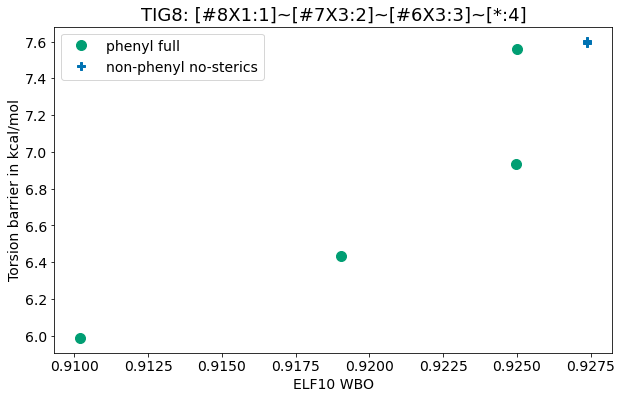

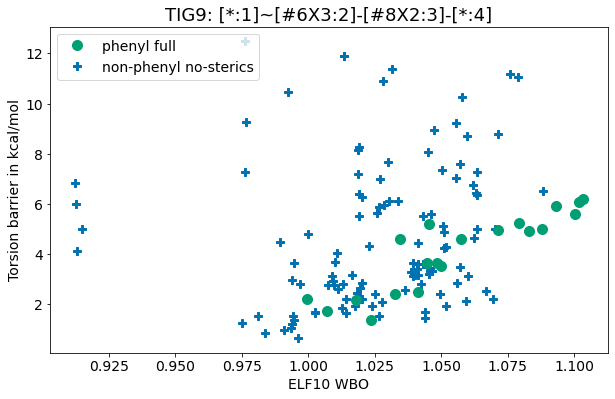

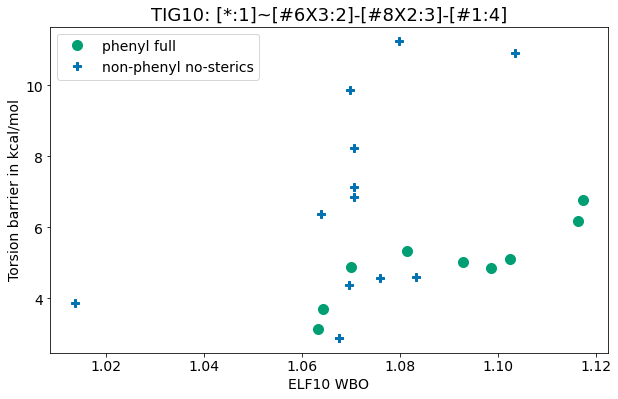

In [51]:
CB_color_cycle = ['#0072B2', '#009E73', '#D55E00', '#F0E442', '#CC79A7', '#56B4E9']
for i in range(10):
    i = i + 1
    key = 'TIG'+str(i)
    plt.figure(figsize=(10,6))
    plt.title(key+": "+tig_labels[key], fontsize=18)
    plt.xlabel('ELF10 WBO', fontsize=14)
    plt.ylabel('Torsion barrier in kcal/mol', fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    
    
    # set of molecules beyond phenyl set
    for j in range(len(non_phenyl_set_df)):
        k = 0
        if non_phenyl_set_df.iloc[j]['assigned params']['tig_proof_of_concept_v130'] == key:
            plt.plot(float(non_phenyl_set_df.iloc[j]['wbo']), float(non_phenyl_set_df.iloc[j]['Max - min for (QM - [MM_SF3, MM_1.3.0]) kcal/mol']['tig_proof_of_concept_v130_full']), color=CB_color_cycle[0], marker='P', markersize=8)
    
#     # phenyl set witout strong sterics and in-rings
#     for j in range(len(phenyl_set_df)):
#         k = 0
#         if phenyl_set_df.iloc[j]['assigned params']['tig_proof_of_concept_v130'] == key:
#             plt.plot(np.float(phenyl_set_df.iloc[j]['wbo']), np.float(phenyl_set_df.iloc[j]['Max - min for (QM - [MM_SF3, MM_1.3.0]) kcal/mol']['tig_proof_of_concept_v130_full']), color=CB_color_cycle[1], marker='D', markersize=8)
    
    # full phenyl set on which FF is fit
    for j in range(len(phenyl_full_set_df)):
        k = 0
        if phenyl_full_set_df.iloc[j]['assigned params']['tig_proof_of_concept_v130'] == key:
            plt.plot(float(phenyl_full_set_df.iloc[j]['wbo']), float(phenyl_full_set_df.iloc[j]['Max - min for (QM - [MM_SF3, MM_1.3.0]) kcal/mol']['tig_proof_of_concept_v130_full']), color=CB_color_cycle[1], marker='o', markersize=10)
    
#     plt.plot([], [], color=CB_color_cycle[1], marker='D', linestyle='None',
#                           markersize=8, label='phenyl no-sterics')
    plt.plot([], [], color=CB_color_cycle[1], marker='o', linestyle='None',
                      markersize=10, label='phenyl full')
    plt.plot([], [], color=CB_color_cycle[0], marker='P', linestyle='None',
                  markersize=8, label='non-phenyl no-sterics')
    plt.legend(fontsize=14)
    plt.show()

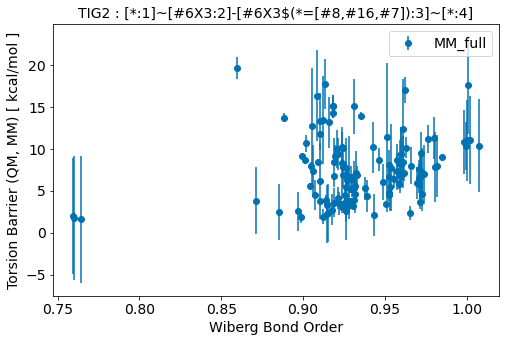

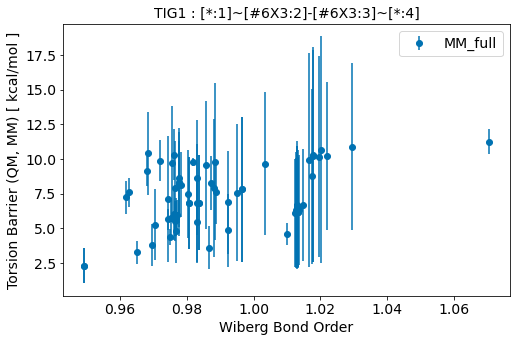

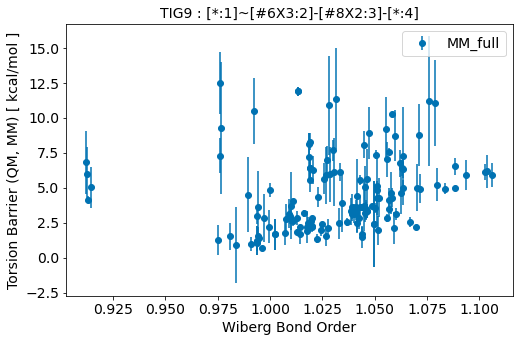

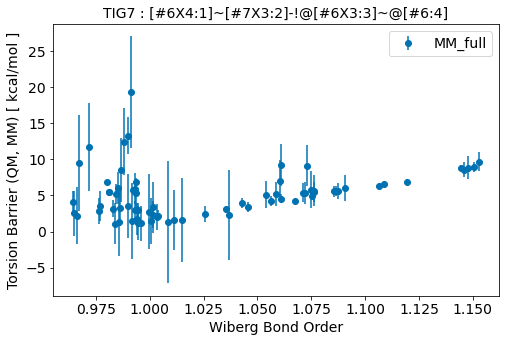

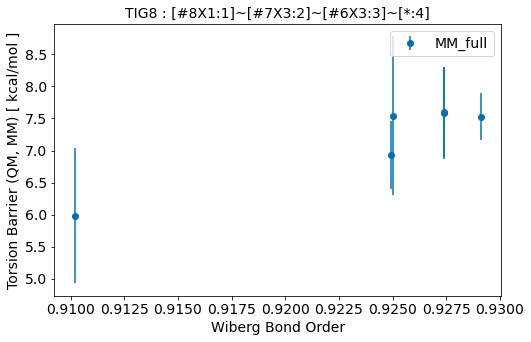

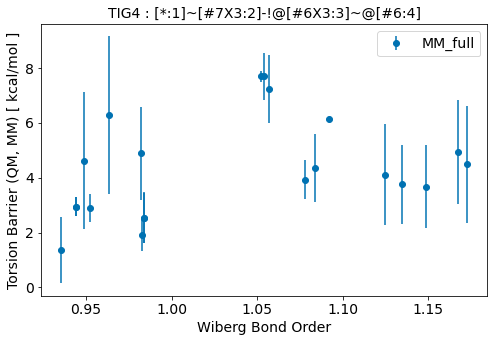

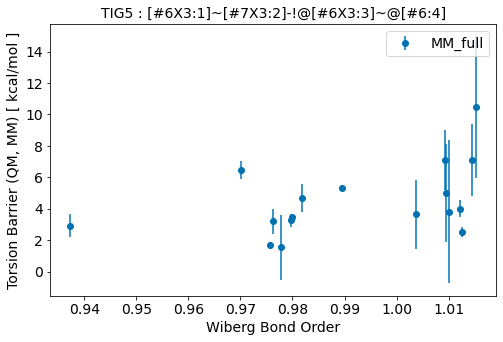

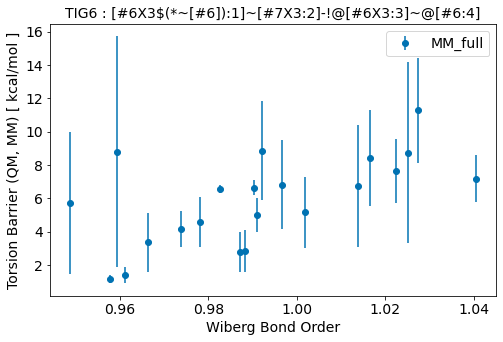

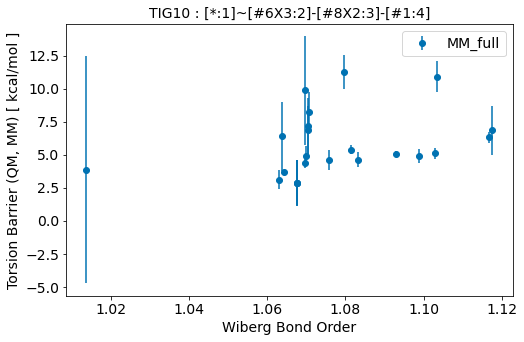

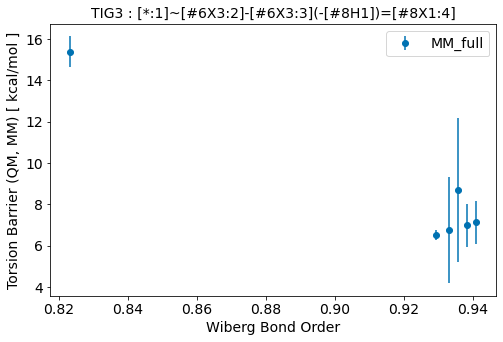

In [13]:
CB_color_cycle = ['#0072B2', '#009E73', '#D55E00', '#CC79A7', '#F0E442', '#56B4E9']
tigs_dict = defaultdict(list) #{'TIG0':[], 'TIG1c':[], 'TIG1d':[], 'TIG2':[], 'TIG3':[], 'TIG4':[], 'TIG5a':[], 'TIG6':[], 'TIG7':[], 'TIG8':[]}
plot_key = ['QM', 'tig_proof_of_concept_v130_full']
ff_key = 'tig_proof_of_concept_v130'
for i in range(len(df)):
    tig_key = df.iloc[i]['assigned params'][ff_key]
    tigs_dict[tig_key].append([df.iloc[i][cols[2]], df.iloc[i][cols[3]][plot_key[1]], df.iloc[i][cols[3]][plot_key[0]]])

title_labels = defaultdict(str)
for i in range(10):
    i = i + 1
    key = 'TIG'+str(i)
    title_labels[key] = ": "+tig_labels[key]
mae_qmmm = defaultdict(float)
for key, value in tigs_dict.items():
    x_wbo = []
    y_barrier = []
    y_barrier_qm = []
    y_err = []
    for i in range(len(value)):
        x_wbo.append(value[i][0])
        y_barrier.append(value[i][1])
        y_barrier_qm.append(value[i][2])
        y_err.append(abs(value[i][2] - value[i][1]))
    mae_qmmm[key] = np.mean(y_err)
    plt.figure(figsize=(8,5))
    x_wbo = [float(i) for i in x_wbo]
    y_barrier = [float(i) for i in y_barrier]
    x_wbo = np.array(x_wbo)
    y_barrier = np.array(y_barrier)
    y_barrier_qm = [float(i) for i in y_barrier_qm]
    plt.errorbar(x_wbo, y_barrier, y_err, color=CB_color_cycle[0], marker='o', label='MM_full', linestyle="None")
#     plt.scatter(x_wbo, y_barrier_qm, color=CB_color_cycle[1], marker='D', label='QM', s=100)
#     b, m = np.polyfit(np.array(x_wbo), y_barrier, 1)
#     plt.plot(x_wbo, b + m * x_wbo, '-', color=CB_color_cycle[0])
    plt.title(key+' '+title_labels[key], fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylabel("Torsion Barrier (QM, MM) [ kcal/mol ]", fontsize=14)
    plt.xlabel("Wiberg Bond Order", fontsize=14)
    plt.legend(fontsize=14)

In [ ]:
OrderedDict(sorted(mae_qmmm.items(), key=lambda t: t[0]))

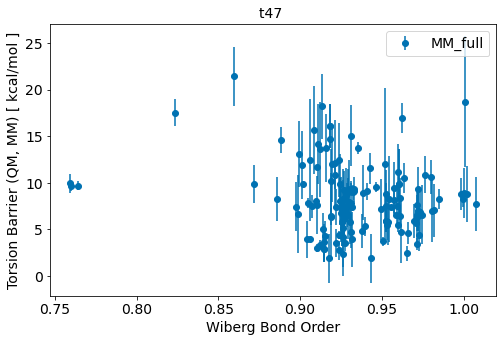

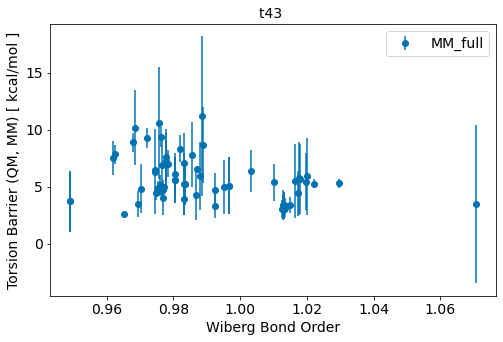

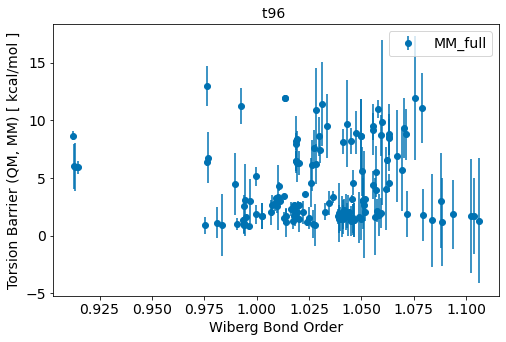

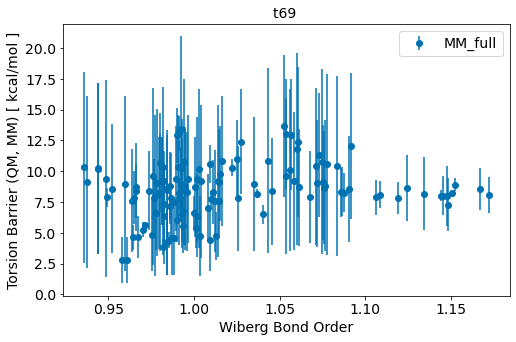

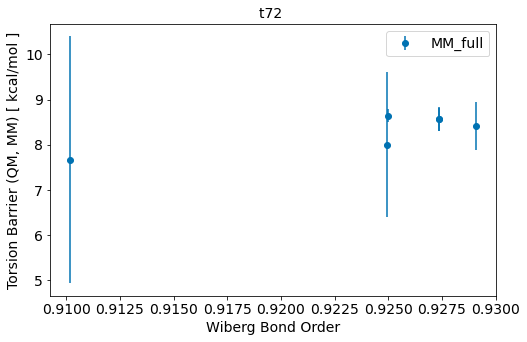

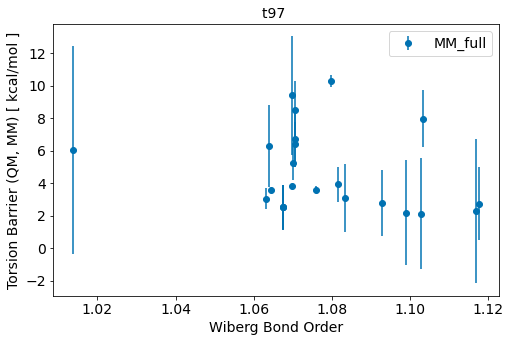

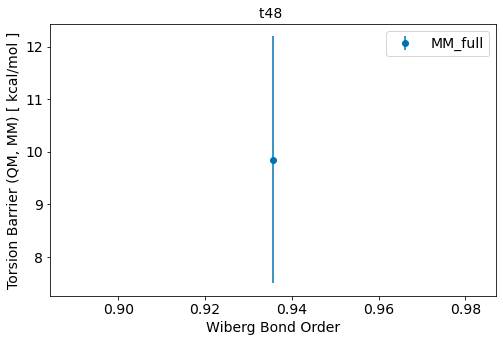

In [14]:
CB_color_cycle = ['#0072B2', '#009E73', '#D55E00', '#CC79A7', '#F0E442', '#56B4E9']
tigs_dict = defaultdict(list) #{'TIG0':[], 'TIG1c':[], 'TIG1d':[], 'TIG2':[], 'TIG3':[], 'TIG4':[], 'TIG5a':[], 'TIG6':[], 'TIG7':[], 'TIG8':[]}
plot_key = ['QM', 'openff_unconstrained-1.3.0_full']
ff_key = 'openff_unconstrained-1.3.0'
for i in range(len(df)):
    tig_key = df.iloc[i]['assigned params'][ff_key]
    tigs_dict[tig_key].append([df.iloc[i][cols[2]], df.iloc[i][cols[3]][plot_key[1]], df.iloc[i][cols[3]][plot_key[0]]])

title_labels = defaultdict(str)
for i in range(10):
    i = i + 1
    key = 'TIG'+str(i)
    title_labels[key] = ": "+tig_labels[key]
mae_qmmm_130 = defaultdict(float)

for key, value in tigs_dict.items():
    x_wbo = []
    y_barrier = []
    y_barrier_qm = []
    y_err = []
    for i in range(len(value)):
        x_wbo.append(value[i][0])
        y_barrier.append(value[i][1])
        y_barrier_qm.append(value[i][2])
        y_err.append(abs(value[i][2] - value[i][1]))
    mae_qmmm_130[key] = np.mean(y_err)
    plt.figure(figsize=(8,5))
    x_wbo = [float(i) for i in x_wbo]
    y_barrier = [float(i) for i in y_barrier]
    x_wbo = np.array(x_wbo)
    y_barrier = np.array(y_barrier)
    y_barrier_qm = [float(i) for i in y_barrier_qm]
    plt.errorbar(x_wbo, y_barrier, y_err, color=CB_color_cycle[0], marker='o', label='MM_full', linestyle="None")
#     plt.scatter(x_wbo, y_barrier_qm, color=CB_color_cycle[1], marker='D', label='QM', s=100)
#     b, m = np.polyfit(np.array(x_wbo), y_barrier, 1)
#     plt.plot(x_wbo, b + m * x_wbo, '-', color=CB_color_cycle[0])
    plt.title(key+' '+title_labels[key], fontsize=14)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.ylabel("Torsion Barrier (QM, MM) [ kcal/mol ]", fontsize=14)
    plt.xlabel("Wiberg Bond Order", fontsize=14)
    plt.legend(fontsize=14)

In [ ]:
OrderedDict(sorted(mae_qmmm_130.items(), key=lambda t: t[0]))

In [48]:
df.loc[:,'mapped_smiles'] = pd.Series(np.random.randn(len(df)), index=df.index)
for i in range(len(df)):
    tid = df.iloc[i]['Torsion ID']
    mol = Molecule.from_file(target_dir+'/QCP-'+tid+'/mol.sdf', allow_undefined_stereo=True)
    df['mapped_smiles'][i] = mol.to_smiles(mapped=True)

<ipython-input-48-e9f5ec5b9004>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['mapped_smiles'][i] = mol.to_smiles(mapped=True)
/home/maverick/anaconda3/envs/fb_dev_env/lib/python3.8/site-packages/pandas/core/indexing.py:1637: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [9]:
key = 'TIG10'

# Plotmol plots

In [18]:
from bokeh.io import output_notebook
output_notebook()

Loading BokehJS ...

In [36]:
from bokeh.plotting import Figure
from plotmol.plotmol import default_tooltip_template

figure = Figure(
    # Required to show the molecule structure pop-up.
    tooltips=default_tooltip_template(),
    
    # Plot options. See the bokeh documentation for more information.
    title="WBO - "+key+ ' ' + tig_labels[key],
    x_axis_label="ELF10 WBO",
    y_axis_label="Torsion barrier kcal/mol",
    
    plot_width=500,
    plot_height=500,
)

In [37]:
from bokeh.palettes import Spectral4
import plotmol

# Define a simple color palette.
palette = Spectral4

# Plot data to the figure.
for j in range(len(non_phenyl_set_df)):
        k = 0
        if non_phenyl_set_df.iloc[j]['assigned params']['tig_proof_of_concept_v130'] == key:
            plotmol.scatter(figure,
                            x = [float(non_phenyl_set_df.iloc[j]['wbo'])], 
                            y = [float(non_phenyl_set_df.iloc[j]['Max - min for (QM - [MM_SF3, MM_1.3.0]) kcal/mol']['tig_proof_of_concept_v130_full'])], 
                            smiles = [non_phenyl_set_df.iloc[j]['mapped_smiles']],
                            marker="x",
                            marker_size=15,
                            marker_color=palette[0],
                            legend_label="General set"
                            )
            
#phenyl_full_set_df
for j in range(len(phenyl_full_set_df)):
        k = 0
        if phenyl_full_set_df.iloc[j]['assigned params']['tig_proof_of_concept_v130'] == key:
            plotmol.scatter(figure,
                            x = [float(phenyl_full_set_df.iloc[j]['wbo'])], 
                            y = [float(phenyl_full_set_df.iloc[j]['Max - min for (QM - [MM_SF3, MM_1.3.0]) kcal/mol']['tig_proof_of_concept_v130_full'])], 
                            smiles = [phenyl_full_set_df.iloc[j]['mapped_smiles']],
                            marker="o",
                            marker_size=12,
                            marker_color=palette[0],
                            legend_label="Sub. phenyl set"
                            )

In [38]:
non_phenyl_set_df.iloc[j]['mapped_smiles']

'[H:1][c:2]1[c:7]([c:6]([c:5]([c:4]([c:3]1[H:17])[H:16])[C:10]2=[N:11][N:12]=[N:13][N:14]2[H:15])[H:9])[H:8]'

In [39]:
from bokeh.plotting import show
show(figure)

In [41]:
from bokeh.plotting import output_file,save
output_file(f"WBO_plotmol_interactiveplot/bokeh_interactive.html")

In [42]:
save(figure)

'/home/maverick/Desktop/OpenFF/dev-dir/wbointerpolation/residuals_calc/WBO_plotmol_interactiveplot/bokeh_interactive.html'